<a href="https://colab.research.google.com/github/harikrishnanp2551/BMI-Calculator-Python/blob/main/svi_calculation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#import libraries

import ee
import geemap
!pip install xee
import xee
import xarray as xr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 74.2 MB/s eta 0:00:00


In [5]:
ee.Authenticate()
ee.Initialize(
    project = 'bugadvocate',
    opt_url = 'https://earthengine-highvolume.googleapis.com'
)

*** Earth Engine *** Share your feedback by taking our Annual Developer Satisfaction Survey: https://google.qualtrics.com/jfe/form/SV_7TDKVSyKvBdmMqW?ref=4i2o6


In [6]:
map = geemap.Map(basemap = 'SATELLITE')
map

Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

In [7]:
roi = map.draw_last_feature.geometry()
map.addLayer(roi, {}, 'ROI')

In [8]:
roi


ee.Geometry({
  "functionInvocationValue": {
    "functionName": "Feature.geometry",
    "arguments": {
      "feature": {
        "functionInvocationValue": {
          "functionName": "Feature",
          "arguments": {
            "geometry": {
              "functionInvocationValue": {
                "functionName": "GeometryConstructors.Polygon",
                "arguments": {
                  "coordinates": {
                    "constantValue": [
                      [
                        [
                          86.791992,
                          22.105999
                        ],
                        [
                          86.791992,
                          28.613459
                        ],
                        [
                          97.558592,
                          28.613459
                        ],
                        [
                          97.558592,
                          22.105999
                        ],
                        [
                          86.791992,
                          22.105999
                        ]
                      ]
                    ]
                  },
                  "geodesic": {
                    "constantValue": false
                  }
                }
              }
            }
          }
        }
      }
    }
  }
})

In [9]:
evi = (
    ee.ImageCollection("NASA/VIIRS/002/VNP13A1")
    .filterDate('2015','2025')
    .select('EVI')
    .map(lambda x: x.clip(roi).copyProperties(x, ['system:time_start']))
)

evi

In [10]:
df = xr.open_dataset(
    evi,
    engine = 'ee',
    crs = 'EPSG:4326',
    geometry = roi,
    scale = 0.01
)

In [11]:
df = df.sortby('time')*1

In [12]:
df_mean = df.mean(dim='time')
df_std = df.std(dim='time')
svi = (df -df_mean)/df_std

In [13]:
svi_annual = svi.resample(time='1Y').mean('time')

In [14]:
import matplotlib.pyplot as plt

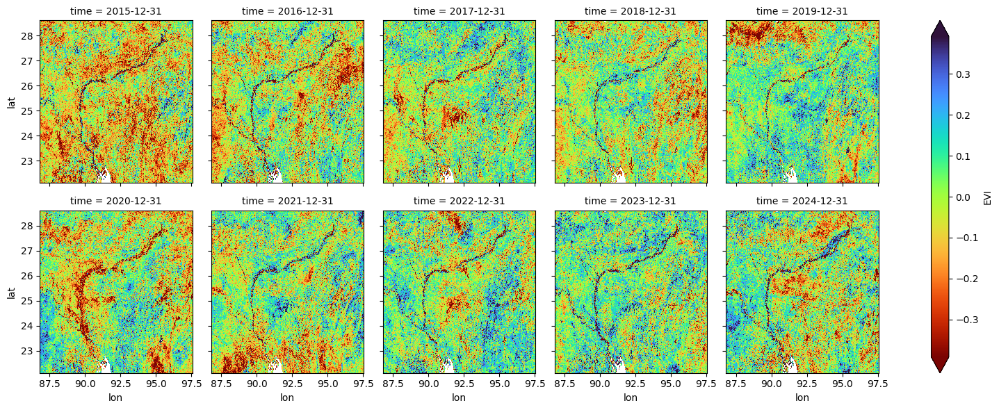

In [15]:
svi_annual.EVI.plot(
    x = 'lon',
    y = 'lat',
    col = 'time',
    col_wrap = 5,
    cmap = 'turbo_r',
    robust = True
)

plt.savefig('svi_annual.png', dpi = 360, bbox_inches = 'tight')

In [16]:
svi_monthly = svi.resample(time='1M').mean('time')

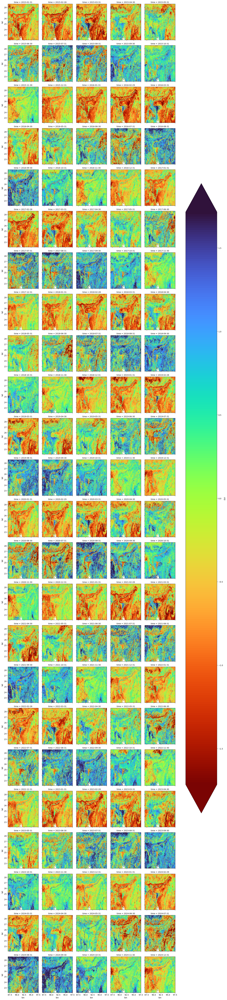

In [17]:
svi_monthly.EVI.plot(
    x = 'lon',
    y = 'lat',
    col = 'time',
    col_wrap = 5,
    cmap = 'turbo_r',
    robust = True
)

plt.savefig('svi_monthly.png', dpi = 360, bbox_inches = 'tight')

<Axes: xlabel='time'>

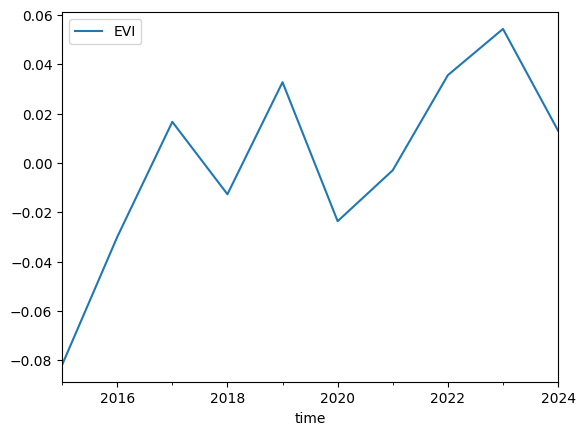

In [18]:
svi_annual_mean = svi_annual.mean(dim = ['lon', 'lat'])
svi_annual_df = svi_annual_mean.to_dataframe().dropna()
svi_annual_df.to_csv('svi_annual.csv')

svi_annual_df.plot()

<Axes: xlabel='time'>

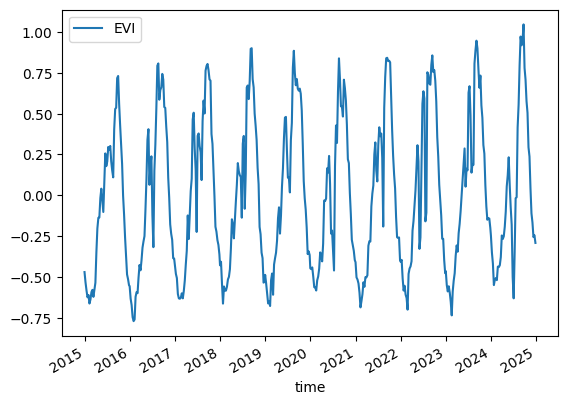

In [19]:
svi_mean = svi.mean(dim = ['lon', 'lat'])
svi_mean_df = svi_mean.to_dataframe().dropna()
svi_mean_df.to_csv('svi_16days.csv')

svi_mean_df.plot()